
## Datos

In [1]:
import geopandas as gpd

uk_county_districts = gpd.read_file("https://github.com/UK-Data-Science/geodf_operations/raw/main/maps/uk/_UK_County_Districts/UK_DISTRICTS_COUNTIES_CENSUS2011.shp")
uk_water = gpd.read_file("https://github.com/UK-Data-Science/geodf_operations/raw/main/maps/uk/uk_waters/hotosm_gbr_waterways_lines_shp.shp")
#uk_neighbourhood_points = gpd.read_file("https://github.com/UK-Data-Science/geodf_operations/raw/main/maps/uk/uk_neighbourhood_points/whosonfirst-data-admin-gb-neighbourhood-point.shp")
uk_macroregions = gpd.read_file("https://github.com/UK-Data-Science/geodf_operations/raw/main/maps/uk/uk_macroregions/whosonfirst-data-admin-gb-macroregion-polygon.shp")
#uk_postal_regions = gpd.read_file("https://github.com/UK-Data-Science/geodf_operations/raw/main/maps/uk/uk_postal_region/whosonfirst-data-admin-gb-postalregion-polygon.shp")
uk_railways = gpd.read_file("https://github.com/UK-Data-Science/geodf_operations/raw/main/maps/uk/uk_railways/hotosm_gbr_railways_lines_shp.shp")
uk_localadmin = gpd.read_file("https://github.com/UK-Data-Science/geodf_operations/raw/main/maps/uk/uk_localadmin/whosonfirst-data-admin-gb-localadmin-polygon.shp")

In [2]:
linkWorldMap="https://github.com/CienciaDeDatosEspacial/intro_geodataframe/raw/main/maps/worldMaps.gpkg"

from  fiona import listlayers
listlayers(linkWorldMap)

['countries', 'rivers', 'cities', 'indicators']

In [3]:
countries=gpd.read_file(linkWorldMap,layer='countries')
rivers=gpd.read_file(linkWorldMap,layer='rivers')
cities=gpd.read_file(linkWorldMap,layer='cities')
indicators=gpd.read_file(linkWorldMap,layer='indicators')

## Exercise 1

1.   Follow the same steps in this last section to plot three maps of one country. Do not use Brazil.
2.   Plot your three layers.

In [4]:
uk = countries[countries.COUNTRY=='United Kingdom']

In [5]:
citiesUk_clipped = gpd.clip(gdf=cities,
                          mask=uk)
riversUk_clipped = gpd.clip(gdf=rivers,
                               mask=uk)

There's no main rivers in UK (?)

ValueError: aspect must be finite and positive 

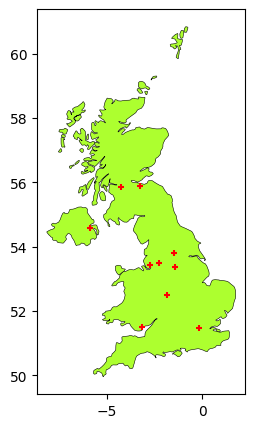

In [ ]:
base = uk.plot(facecolor="greenyellow", edgecolor='black', linewidth=0.4,figsize=(5,5))
citiesUk_clipped.plot(marker='+', color='red', markersize=15,
                    ax=base)
riversUk_clipped.plot(edgecolor='blue', linewidth=0.5,
                    ax=base)

In [13]:
watersUk_clipped = gpd.clip(gdf=uk_water,
                               mask=uk)

<ipython-input-13-e847eb4efef6>:1: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:4326

  watersUk_clipped = gpd.clip(gdf=uk_water,


<Axes: >

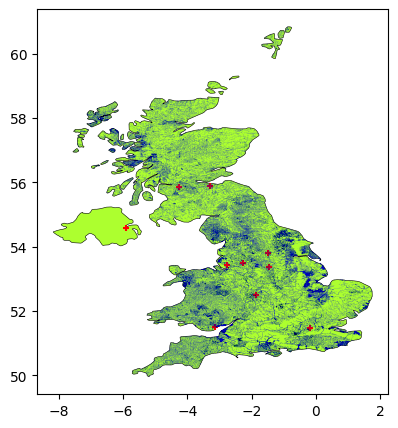

In [14]:
base = uk.plot(facecolor="greenyellow", edgecolor='black', linewidth=0.4,figsize=(5,5))
citiesUk_clipped.plot(marker='+', color='red', markersize=15,
                    ax=base)
watersUk_clipped.plot(edgecolor='blue', linewidth=0.1, alpha=0.5,
                    ax=base)

## Exercise 2

1. Reproject your country's map layers.
2. Plot the reprojected layers
3. Save the reprojected layers

In [15]:
uk.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [16]:
uk.crs.axis_info

[Axis(name=Geodetic latitude, abbrev=Lat, direction=north, unit_auth_code=EPSG, unit_code=9122, unit_name=degree),
 Axis(name=Geodetic longitude, abbrev=Lon, direction=east, unit_auth_code=EPSG, unit_code=9122, unit_name=degree)]

In [17]:
uk.crs.is_projected

False

In [18]:
uk.centroid

<ipython-input-18-7f56de6fd8e7>:1: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  uk.centroid


227    POINT (-2.89558 54.15535)
dtype: geometry

In [19]:
uk.to_crs(27700).crs.axis_info

[Axis(name=Easting, abbrev=E, direction=east, unit_auth_code=EPSG, unit_code=9001, unit_name=metre),
 Axis(name=Northing, abbrev=N, direction=north, unit_auth_code=EPSG, unit_code=9001, unit_name=metre)]

In [20]:
uk.to_crs(27700).centroid

227    POINT (348609.801 461152.220)
dtype: geometry

<Axes: >

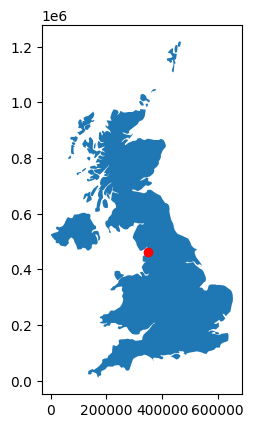

In [21]:
# replotting:

base27700=uk.to_crs(27700).plot()
uk.to_crs(27700).centroid.plot(color='red',ax=base27700)

In [22]:
uk_27700=uk.to_crs(27700)
cities_uk_27700=citiesUk_clipped.to_crs(uk_27700.crs)
rivers_uk_27700=riversUk_clipped.to_crs(uk_27700.crs)

In [23]:
## saving

import os

uk_27700.to_file(os.path.join("maps","ukMaps_27700.gpkg"), layer='country', driver="GPKG")
cities_uk_27700.to_file(os.path.join("maps","ukMaps_27700.gpkg"), layer='cities', driver="GPKG")
rivers_uk_27700.to_file(os.path.join("maps","ukMaps_27700.gpkg"), layer='rivers', driver="GPKG")
uk_27700.centroid.to_file(os.path.join("maps","ukMaps_27700.gpkg"), layer='centroid', driver="GPKG")

/usr/local/lib/python3.10/dist-packages/geopandas/io/file.py:572: UserWarning: You are attempting to write an empty DataFrame to file. For some drivers, this operation may fail.
  _to_file_fiona(df, filename, driver, schema, crs, mode, **kwargs)


## Exercise 3

1. Find the airports for your country [here](https://ourairports.com/data/). The data is in a CSV file.
2. Create projected layer of airports.
3. Plot all the layers and airports on top.

In [24]:
import pandas as pd
infoairports=pd.read_csv("https://github.com/UK-Data-Science/geodf_operations/raw/main/maps/uk/airports.csv")

# some rows

infoairports.iloc[[0,1,2,3,-4,-3,-2,-1],:] #head and tail

,id,ident,type,name,latitude_deg,longitude_deg,elevation_ft,continent,iso_country,iso_region,municipality,scheduled_service,gps_code,iata_code,local_code,home_link,wikipedia_link,keywords
0,6523,00A,heliport,Total RF Heliport,40.070985,-74.933689,11.0,NaN,US,US-PA,Bensalem,no,K00A,NaN,00A,https://www.penndot.pa.gov/TravelInPA/airports...,NaN,NaN
1,323361,00AA,small_airport,Aero B Ranch Airport,38.704022,-101.473911,3435.0,NaN,US,US-KS,Leoti,no,00AA,NaN,00AA,NaN,NaN,NaN
2,6524,00AK,small_airport,Lowell Field,59.947733,-151.692524,450.0,NaN,US,US-AK,Anchor Point,no,00AK,NaN,00AK,NaN,NaN,NaN
3,6525,00AL,small_airport,Epps Airpark,34.864799,-86.770302,820.0,NaN,US,US-AL,Harvest,no,00AL,NaN,00AL,NaN,NaN,NaN
79581,307326,ZZ-0002,small_airport,Glorioso Islands Airstrip,-11.584278,47.296389,11.0,AF,TF,TF-U-A,Grande Glorieuse,no,NaN,NaN,NaN,NaN,NaN,NaN
79582,346788,ZZ-0003,small_airport,Fainting Goat Airport,32.110587,-97.356312,690.0,NaN,US,US-TX,Blum,no,87TX,NaN,87TX,NaN,NaN,NaN
79583,342102,ZZZW,closed,Scandium City Heliport,69.355287,-138.939310,4.0,NaN,CA,CA-YT,(Old) Scandium City,no,NaN,NaN,NaN,NaN,NaN,"ZZZW, ZZZW, ZYW, YK96"
79584,313629,ZZZZ,small_airport,Satsuma Iōjima Airport,30.784722,130.270556,338.0,AS,JP,JP-46,Mishima,no,RJX7,NaN,RJX7,NaN,http://wikimapia.org/6705190/Satsuma-Iwo-jima-...,"SATSUMA,IWOJIMA,RJX7"


In [25]:
infoairports.drop(index=0,inplace=True)
infoairports.reset_index(drop=True, inplace=True)
infoairports.head()

,id,ident,type,name,latitude_deg,longitude_deg,elevation_ft,continent,iso_country,iso_region,municipality,scheduled_service,gps_code,iata_code,local_code,home_link,wikipedia_link,keywords
0,323361,00AA,small_airport,Aero B Ranch Airport,38.704022,-101.473911,3435.0,NaN,US,US-KS,Leoti,no,00AA,NaN,00AA,NaN,NaN,NaN
1,6524,00AK,small_airport,Lowell Field,59.947733,-151.692524,450.0,NaN,US,US-AK,Anchor Point,no,00AK,NaN,00AK,NaN,NaN,NaN
2,6525,00AL,small_airport,Epps Airpark,34.864799,-86.770302,820.0,NaN,US,US-AL,Harvest,no,00AL,NaN,00AL,NaN,NaN,NaN
3,506791,00AN,small_airport,Katmai Lodge Airport,59.093287,-156.456699,80.0,NaN,US,US-AK,King Salmon,no,00AN,NaN,00AN,NaN,NaN,NaN
4,6526,00AR,closed,Newport Hospital & Clinic Heliport,35.608700,-91.254898,237.0,NaN,US,US-AR,Newport,no,NaN,NaN,NaN,NaN,NaN,00AR


In [26]:
infoairports.columns

Index(['id', 'ident', 'type', 'name', 'latitude_deg', 'longitude_deg',
       'elevation_ft', 'continent', 'iso_country', 'iso_region',
       'municipality', 'scheduled_service', 'gps_code', 'iata_code',
       'local_code', 'home_link', 'wikipedia_link', 'keywords'],
      dtype='object')

In [27]:
keep=['name','type','latitude_deg', 'longitude_deg','elevation_ft','iso_region','municipality']
infoairports=infoairports.loc[:,keep]

infoairports.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 79584 entries, 0 to 79583
Data columns (total 7 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   name           79584 non-null  object 
 1   type           79584 non-null  object 
 2   latitude_deg   79584 non-null  float64
 3   longitude_deg  79584 non-null  float64
 4   elevation_ft   64822 non-null  float64
 5   iso_region     79584 non-null  object 
 6   municipality   73972 non-null  object 
dtypes: float64(3), object(4)
memory usage: 4.3+ MB


In [28]:
airports=gpd.GeoDataFrame(data=infoairports.copy(),
                 geometry=gpd.points_from_xy(infoairports.longitude_deg,
                                             infoairports.latitude_deg),
                 crs=uk.crs.to_epsg())# the coordinates were in degrees - unprojected

<Axes: >

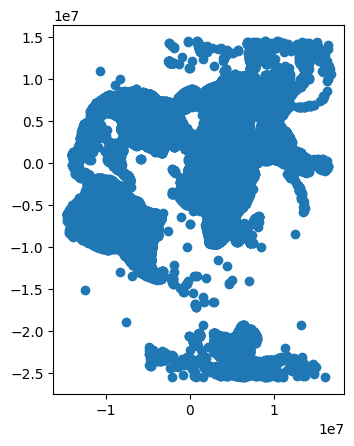

In [29]:
airports_27700=airports.to_crs(27700)

base = uk_27700.plot(color='white', edgecolor='black')
airports_27700.plot(ax=base)

In [33]:
import numpy as np

# Replace infinite values with NaN
airports_27700.geometry = airports_27700.geometry.replace([np.inf, -np.inf], np.nan)

# Drop rows with NaN values in geometry column
airports_27700 = airports_27700.dropna(subset=['geometry'])
airports_27700.geometry = airports_27700.geometry.buffer(0)

# Now try to save the GeoDataFrame to a GeoPackage file
airports_27700.to_file(os.path.join("maps","ukMaps_27700.gpkg"), layer='airports', driver="GPKG")

## Exercise 4

1. Check if your country is a polygon or multipolygon.
    
2. Recover just the boundaries of that country.
    
3. Turn the boundary into a GDF.

In [34]:
uk_27700

,COUNTRY,geometry
227,United Kingdom,"MULTIPOLYGON (((463756.092 1199463.383, 458260..."


In [35]:
uk_27700.boundary

227    MULTILINESTRING ((463756.092 1199463.383, 4582...
dtype: geometry

<Axes: >

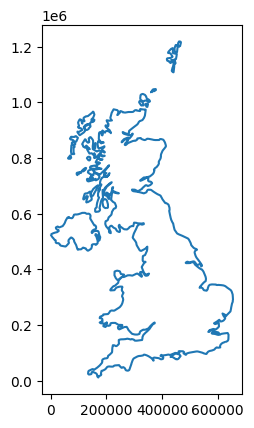

In [36]:
uk_27700.boundary.plot()

In [37]:
type(uk_27700.boundary)

geopandas.geoseries.GeoSeries

In [38]:
uk_27700.boundary.to_frame()

,0
227,"MULTILINESTRING ((463756.092 1199463.383, 4582..."


In [39]:
# conversion
uk_border=uk_27700.boundary.to_frame()

# new column (optional)
uk_border['name']='UK'

# renaming the geometry column
uk_border.rename(columns={0:'geometry'},inplace=True)

#setting the geometry (the name is not enough)
uk_border = uk_border.set_geometry("geometry")

# verifying:
uk_border.crs

<Projected CRS: EPSG:27700>
Name: OSGB36 / British National Grid
Axis Info [cartesian]:
- E[east]: Easting (metre)
- N[north]: Northing (metre)
Area of Use:
- name: United Kingdom (UK) - offshore to boundary of UKCS within 49°45'N to 61°N and 9°W to 2°E; onshore Great Britain (England, Wales and Scotland). Isle of Man onshore.
- bounds: (-9.01, 49.75, 2.01, 61.01)
Coordinate Operation:
- name: British National Grid
- method: Transverse Mercator
Datum: Ordnance Survey of Great Britain 1936
- Ellipsoid: Airy 1830
- Prime Meridian: Greenwich

## Exercise 5
1. Look for sub administrative divisions of your country
2. Check all the CRSs of those divisions
3. If you find one CRS is missing, fill the CRS with the right projection.

In [40]:
uk_county_districts.geometry.head()

0    MULTIPOLYGON (((-1.24281 54.72227, -1.24221 54...
1    MULTIPOLYGON (((-1.20097 54.57760, -1.20171 54...
2    MULTIPOLYGON (((-0.79421 54.55835, -0.79409 54...
3    MULTIPOLYGON (((-1.25075 54.62531, -1.25074 54...
4    POLYGON ((-1.43833 54.59508, -1.43810 54.59494...
Name: geometry, dtype: geometry

In [41]:
uk_county_districts.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

## Exercise 6
1. Create some subset of polygons with your country data.
2. Use Unary UNION with those  polygons.
3. Create a geoDF with the result.
4. Use dissolve with the same polygons, and create a geoDF.

<Axes: >

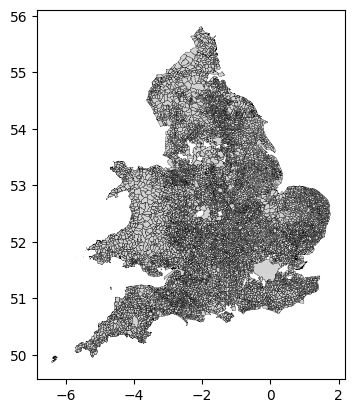

In [ ]:
uk_localadmin.plot(facecolor='lightgrey', edgecolor='black',linewidth=0.2)

In [ ]:
uk_localadmin.head()

,id,parent_id,name,placetype,placelocal,country,repo,lat,lon,min_lat,...,name_rus,name_spa,name_swe,name_tur,name_ukr,name_urd,name_vie,name_zho,geom_src,geometry
0,101750297,1360698841,Plymouth,locality,None,GB,whosonfirst-data-admin-gb,50.393988,-4.113637,50.340841,...,Плимут,Plymouth,Plymouth,Plymouth,Плімут,پلایماؤتھ,Plymouth,普利茅斯,quattroshapes,"POLYGON ((-4.05023 50.37653, -4.05024 50.37642..."
1,101750303,1360699019,Brighton and Hove,locality,None,GB,whosonfirst-data-admin-gb,50.847862,-0.142797,50.798141,...,Хов,Hove,Hove,None,Гоув,ہوئے,None,荷甫,quattroshapes,"POLYGON ((-0.06771 50.82204, -0.06791 50.82188..."
2,101750305,1880773233,Bournemouth,locality,None,GB,whosonfirst-data-admin-gb,50.740796,-1.864552,50.709050,...,Борнмут,Bournemouth,Bournemouth,Bournemouth,Борнмут,بورنموتھ,None,伯恩茅斯,quattroshapes,"POLYGON ((-1.80923 50.72032, -1.80941 50.72035..."
3,101750307,1360699069,Portsmouth,locality,None,GB,whosonfirst-data-admin-gb,50.817510,-1.078444,50.777470,...,Портсмут,Portsmouth,Portsmouth,Portsmouth,Портсмут,پورٹسماؤتھ,Portsmouth,朴次茅斯,quattroshapes,"POLYGON ((-1.05436 50.85505, -1.05430 50.85522..."
4,101750309,1880773233,Poole,locality,None,GB,whosonfirst-data-admin-gb,50.740994,-1.971466,50.681400,...,Пул,Poole,Poole,None,Пул,پول، انگلستان,None,普爾,quattroshapes,"POLYGON ((-1.94845 50.68140, -1.94908 50.68155..."


In [ ]:
uk_localadmin.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 11523 entries, 0 to 11522
Data columns (total 56 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   id          11523 non-null  int64   
 1   parent_id   11523 non-null  int64   
 2   name        11523 non-null  object  
 3   placetype   11523 non-null  object  
 4   placelocal  11368 non-null  object  
 5   country     11523 non-null  object  
 6   repo        11523 non-null  object  
 7   lat         11523 non-null  float64 
 8   lon         11523 non-null  float64 
 9   min_lat     11523 non-null  float64 
 10  min_lon     11523 non-null  float64 
 11  max_lat     11523 non-null  float64 
 12  max_lon     11523 non-null  float64 
 13  min_zoom    11523 non-null  float64 
 14  max_zoom    2 non-null      object  
 15  min_label   11523 non-null  float64 
 16  max_label   11523 non-null  int64   
 17  modified    11523 non-null  object  
 18  is_funky    1 non-null      object  
 

In [ ]:
uk_localadmin.county_id.value_counts()

Series([], Name: count, dtype: int64)

In [ ]:
uk_localadmin[uk_localadmin.county_id=='1360698753'].head()

,id,parent_id,name,placetype,placelocal,country,repo,lat,lon,min_lat,...,name_rus,name_spa,name_swe,name_tur,name_ukr,name_urd,name_vie,name_zho,geom_src,geometry
73,101750597,1360698753,Harrogate,locality,None,GB,whosonfirst-data-admin-gb,53.988985,-1.533172,53.951823,...,Харрогейт,Harrogate,Harrogate,Harrogate,Харрогейт,ہاروجاتی,None,哈罗盖特,quattroshapes,"POLYGON ((-1.50505 54.01880, -1.50482 54.01884..."
118,101874185,1360698753,Scarborough,locality,None,GB,whosonfirst-data-admin-gb,54.277307,-0.415285,54.246220,...,Скарборо,Scarborough,Scarborough,None,Скарборо,سکاربورو,None,斯卡布羅,whosonfirst,"POLYGON ((-0.36898 54.25578, -0.36960 54.25543..."
151,404429225,1360698753,Ferrensby,localadmin,civil parish,GB,whosonfirst-data-admin-gb,54.034695,-1.439137,54.025449,...,None,None,Ferrensby,None,None,None,None,None,quattroshapes,"POLYGON ((-1.43432 54.04407, -1.43364 54.04400..."
157,404429241,1360698753,Birkin,localadmin,civil parish,GB,whosonfirst-data-admin-gb,53.733245,-1.213180,53.713434,...,None,None,Birkin,None,None,None,None,None,quattroshapes,"POLYGON ((-1.16655 53.72953, -1.16666 53.72959..."
161,404429251,1360698753,Little Busby,localadmin,civil parish,GB,whosonfirst-data-admin-gb,54.444453,-1.220121,54.422878,...,None,None,Little Busby,None,None,None,None,None,quattroshapes,"POLYGON ((-1.22317 54.45534, -1.22290 54.45507..."


<Axes: >

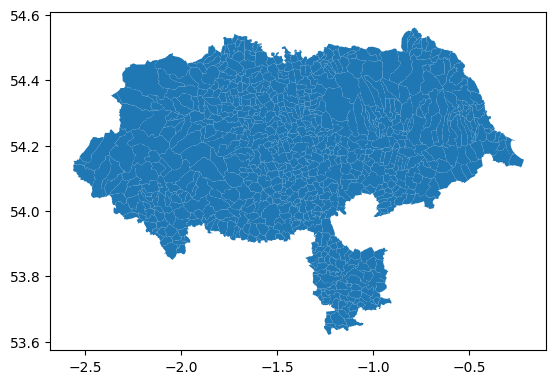

In [ ]:
uk_localadmin[uk_localadmin.county_id=='1360698753'].plot()

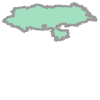

In [ ]:
uk_localadmin[uk_localadmin.county_id=='1360698753'].unary_union

In [ ]:
yorkshire_union=uk_localadmin[uk_localadmin.county_id=='1360698753'].unary_union

In [ ]:
type(yorkshire_union)

shapely.geometry.polygon.Polygon

In [ ]:
gpd.GeoDataFrame(index=[0],data={'county_id':'1360698753'},
                 crs=uk_localadmin.crs,
                 geometry=[yorkshire_union])

,county_id,geometry
0,1360698753,"POLYGON ((-2.02968 53.86105, -2.02983 53.86083..."


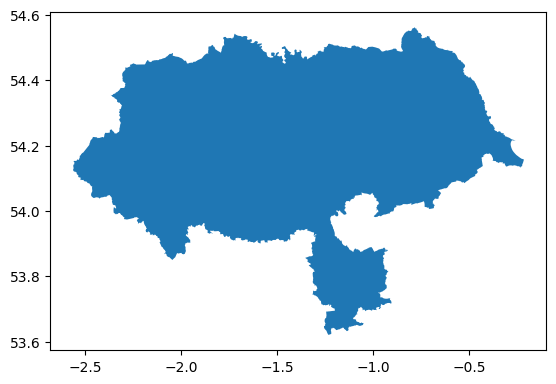

In [ ]:
yorkshire_union=uk_localadmin[uk_localadmin.county_id=='1360698753'].dissolve().plot()

In [ ]:
yorkshire_dissolve=yorkshire_union=uk_localadmin[uk_localadmin.county_id=='1360698753'].dissolve()

# we got?
type(yorkshire_dissolve)

geopandas.geodataframe.GeoDataFrame

In [ ]:
yorkshire_dissolve

,geometry,id,parent_id,name,placetype,placelocal,country,repo,lat,lon,...,name_por,name_rus,name_spa,name_swe,name_tur,name_ukr,name_urd,name_vie,name_zho,geom_src
0,"POLYGON ((-2.02968 53.86105, -2.02983 53.86083...",101750597,1360698753,Harrogate,locality,civil parish,GB,whosonfirst-data-admin-gb,53.988985,-1.533172,...,Harrogate,Харрогейт,Harrogate,Harrogate,Harrogate,Харрогейт,ہاروجاتی,Chì,哈罗盖特,quattroshapes


In [ ]:
keep = ['geometry','country','county_id']
yorkshire_dissolve=yorkshire_dissolve[keep]

In [ ]:
uk_macroregions.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 4 entries, 0 to 3
Data columns (total 56 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   id          4 non-null      int64   
 1   parent_id   4 non-null      int64   
 2   name        4 non-null      object  
 3   placetype   4 non-null      object  
 4   placelocal  4 non-null      object  
 5   country     4 non-null      object  
 6   repo        4 non-null      object  
 7   lat         4 non-null      float64 
 8   lon         4 non-null      float64 
 9   min_lat     4 non-null      float64 
 10  min_lon     4 non-null      float64 
 11  max_lat     4 non-null      float64 
 12  max_lon     4 non-null      float64 
 13  min_zoom    4 non-null      int64   
 14  max_zoom    0 non-null      object  
 15  min_label   4 non-null      int64   
 16  max_label   4 non-null      int64   
 17  modified    4 non-null      object  
 18  is_funky    0 non-null      object  
 19  popu

<Axes: >

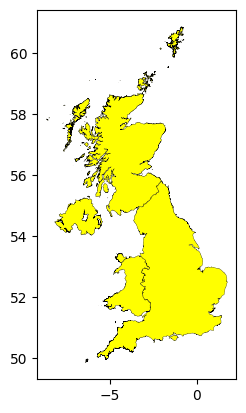

In [ ]:
uk_macroregions.dissolve(by='iso_code').plot(facecolor='yellow', edgecolor='black',linewidth=0.2)

In [ ]:
uk_iso_diss=uk_macroregions.dissolve(by='iso_code')

In [ ]:
uk_iso_diss

,geometry,country,name
iso_code,,,
GB-ENG,"MULTIPOLYGON (((-6.39865 49.86546, -6.39874 49...",GB,England
GB-NIR,"MULTIPOLYGON (((-7.42951 54.16087, -7.42946 54...",GB,Northern Ireland
GB-SCT,"MULTIPOLYGON (((-7.63924 56.78946, -7.63915 56...",GB,Scotland
GB-WLS,"MULTIPOLYGON (((-5.66880 51.72043, -5.66879 51...",GB,Wales


In [ ]:
keep = ['geometry','country','name']
uk_iso_diss = uk_iso_diss[keep]

In [48]:
uk_iso_diss

NameError: name 'uk_iso_diss' is not defined

## Exercise 7

In [49]:
uk_27700.centroid

227    POINT (348609.801 461152.220)
dtype: geometry

In [50]:
uk_27700.centroid.x.values[0],uk_27700.centroid.y.values[0]

(348609.8014521126, 461152.21989169234)

In [51]:
airports_27700

/usr/local/lib/python3.10/dist-packages/geopandas/geoseries.py:751: UserWarning: GeoSeries.notna() previously returned False for both missing (None) and empty geometries. Now, it only returns False for missing values. Since the calling GeoSeries contains empty geometries, the result has changed compared to previous versions of GeoPandas.
Given a GeoSeries 's', you can use '~s.is_empty & s.notna()' to get back the old behaviour.

To further ignore this warning, you can do: 
import warnings; warnings.filterwarnings('ignore', 'GeoSeries.notna', UserWarning)
  return self.notna()


,name,kind,latitude_deg,longitude_deg,elevation_ft,iso_region,municipality,geometry
0,Aero B Ranch Airport,small_airport,38.704022,-101.473911,3435.0,US-KS,Leoti,POLYGON EMPTY
1,Lowell Field,small_airport,59.947733,-151.692524,450.0,US-AK,Anchor Point,POLYGON EMPTY
2,Epps Airpark,small_airport,34.864799,-86.770302,820.0,US-AL,Harvest,POLYGON EMPTY
3,Katmai Lodge Airport,small_airport,59.093287,-156.456699,80.0,US-AK,King Salmon,POLYGON EMPTY
4,Newport Hospital & Clinic Heliport,closed,35.608700,-91.254898,237.0,US-AR,Newport,POLYGON EMPTY
...,...,...,...,...,...,...,...,...
79579,Sealand Helipad,heliport,51.894444,1.482500,40.0,GB-ENG,Sealand,POLYGON EMPTY
79580,Glorioso Islands Airstrip,small_airport,-11.584278,47.296389,11.0,TF-U-A,Grande Glorieuse,POLYGON EMPTY
79581,Fainting Goat Airport,small_airport,32.110587,-97.356312,690.0,US-TX,Blum,POLYGON EMPTY
79582,Scandium City Heliport,closed,69.355287,-138.939310,4.0,CA-YT,(Old) Scandium City,POLYGON EMPTY


In [54]:
# coordinates
centroidX,centroidY=uk_27700.centroid.x.values[0],uk_27700.centroid.y.values[0]

In [55]:
uk_AirTopLeft=airports_27700[airports_27700.kind=='medium_airport'].cx[:centroidX,centroidY:]

/usr/local/lib/python3.10/dist-packages/geopandas/array.py:968: RuntimeWarning: All-NaN slice encountered
  np.nanmin(b[:, 0]),  # minx
/usr/local/lib/python3.10/dist-packages/geopandas/array.py:969: RuntimeWarning: All-NaN slice encountered
  np.nanmin(b[:, 1]),  # miny
/usr/local/lib/python3.10/dist-packages/geopandas/array.py:970: RuntimeWarning: All-NaN slice encountered
  np.nanmax(b[:, 2]),  # maxx
/usr/local/lib/python3.10/dist-packages/geopandas/array.py:971: RuntimeWarning: All-NaN slice encountered
  np.nanmax(b[:, 3]),  # maxy
/usr/local/lib/python3.10/dist-packages/shapely/predicates.py:778: RuntimeWarning: invalid value encountered in intersects
  return lib.intersects(a, b, **kwargs)


In [58]:
uk_AirTopRight=airports_27700[airports_27700.kind=='medium_airport'].cx[centroidX:,centroidY:]
uk_AirBottomLeft=airports_27700[airports_27700.kind=='medium_airport'].cx[:centroidX,:centroidY]
uk_AirBottomRight=airports_27700[airports_27700.kind=='medium_airport'].cx[centroidX:,:centroidY]

/usr/local/lib/python3.10/dist-packages/geopandas/array.py:968: RuntimeWarning: All-NaN slice encountered
  np.nanmin(b[:, 0]),  # minx
/usr/local/lib/python3.10/dist-packages/geopandas/array.py:969: RuntimeWarning: All-NaN slice encountered
  np.nanmin(b[:, 1]),  # miny
/usr/local/lib/python3.10/dist-packages/geopandas/array.py:970: RuntimeWarning: All-NaN slice encountered
  np.nanmax(b[:, 2]),  # maxx
/usr/local/lib/python3.10/dist-packages/geopandas/array.py:971: RuntimeWarning: All-NaN slice encountered
  np.nanmax(b[:, 3]),  # maxy


GEOSException: IllegalArgumentException: Points of LinearRing do not form a closed linestring

/usr/local/lib/python3.10/dist-packages/geopandas/plotting.py:695: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  warnings.warn(


NameError: name 'uk_AirTopRight' is not defined

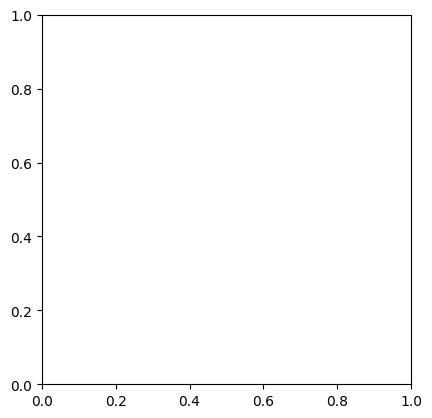

In [53]:
base=uk_AirTopLeft.plot(facecolor='grey', alpha=0.4)
uk_AirTopRight.plot(ax=base,facecolor='orange', alpha=0.4)
uk_AirBottomLeft.plot(ax=base,facecolor='green', alpha=0.4)
uk_AirBottomRight.plot(ax=base,facecolor='red', alpha=0.4)

<Axes: >

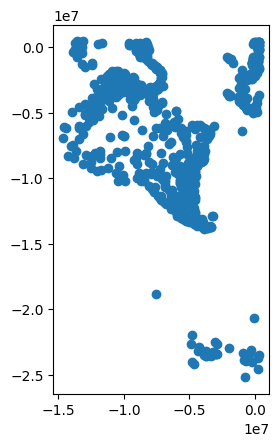

In [ ]:
uk_AirBottomLeft.convex_hull.plot()

<Axes: >

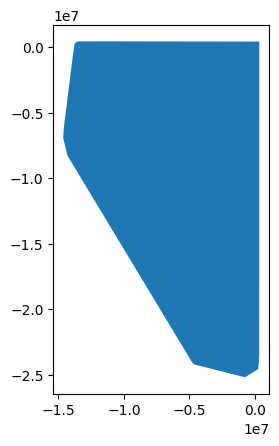

In [ ]:
uk_AirBottomLeft.dissolve().convex_hull.plot()

In [ ]:
uk_AirBottomLeft.dissolve().convex_hull

0    POLYGON ((-749800.382 -25210369.939, -4639401....
dtype: geometry

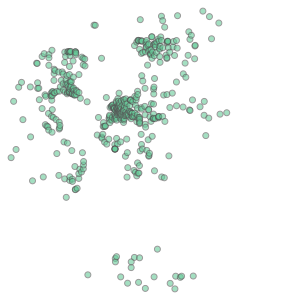

In [ ]:
# just the union
large_airport=airports_27700[airports_27700.kind=='large_airport']
large_airport.unary_union

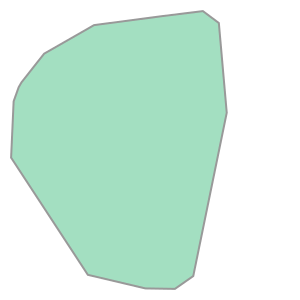

In [ ]:
large_airport.unary_union.convex_hull

In [ ]:
LargeAirport_hull= gpd.GeoDataFrame(index=[0],
                                    crs=large_airport.crs,
                                    geometry=[large_airport.unary_union.convex_hull])
LargeAirport_hull['name']='large airports hull' # optional

# then

LargeAirport_hull

,geometry,name
0,"POLYGON ((9065808.563 -25228120.399, 4900596.6...",large airports hull


<Axes: >

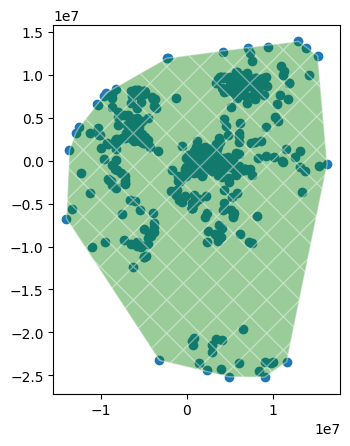

In [ ]:
base=uk_27700.plot(facecolor='yellow')
large_airport.plot(ax=base)
LargeAirport_hull.plot(ax=base,facecolor='green',
                       edgecolor='white',alpha=0.4,
                       hatch='X')

## Exercise 8

In [76]:
# the north
DistN_uk=uk_county_districts.cx[:,centroidY:]
# the south
DistS_uk=uk_county_districts.cx[:,:centroidY]
# the west
DistW_uk=uk_county_districts.cx[:centroidX,:]
# the east
DistE_uk=uk_county_districts.cx[centroidX:,:]

<Axes: >

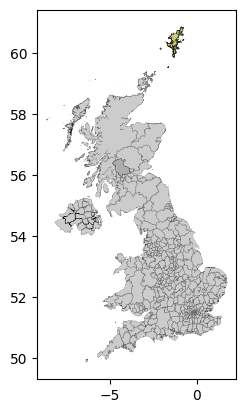

In [77]:
base=DistN_uk.plot(facecolor='yellow', edgecolor='black',linewidth=0.2, alpha=0.6)
DistS_uk.plot(facecolor='grey', edgecolor='black',linewidth=0.2,ax=base, alpha=0.4)

<Axes: >

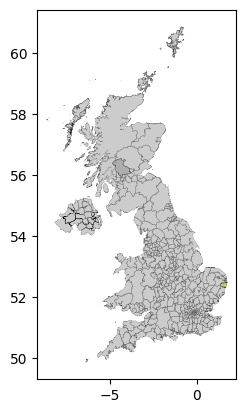

In [78]:
base=DistE_uk.plot(facecolor='yellow', edgecolor='black',linewidth=0.2, alpha=0.6)
DistW_uk.plot(facecolor='grey', edgecolor='black',linewidth=0.2,ax=base, alpha=0.4)

Otros

In [ ]:
centroidX,centroidY=brazil_5641.centroid.x.values[0],brazil_5641.centroid.y.values[0]

In [ ]:
# the north
MunisN_brazil=brazil_municipalities.cx[:,centroidY:]
# the south
MunisS_brazil=brazil_municipalities.cx[:,:centroidY]
# the west
MunisW_brazil=brazil_municipalities.cx[:centroidX,:]
# the east
MunisE_brazil=brazil_municipalities.cx[centroidX:,:]

In [ ]:
Brazil_AirTopLeft=airports_5641[airports_5641.kind=='medium_airport'].cx[:centroidX,centroidY:]
Brazil_AirTopRight=airports_5641[airports_5641.kind=='medium_airport'].cx[centroidX:,centroidY:]
Brazil_AirBottomLeft=airports_5641[airports_5641.kind=='medium_airport'].cx[:centroidX,:centroidY]
Brazil_AirBottomRight=airports_5641[airports_5641.kind=='medium_airport'].cx[centroidX:,:centroidY]

In [ ]:
Brazil_AirTopLeft_hull=Brazil_AirTopLeft.dissolve().convex_hull
Brazil_AirTopRight_hull=Brazil_AirTopRight.dissolve().convex_hull
Brazil_AirBottomLeft_hull=Brazil_AirBottomLeft.dissolve().convex_hull
Brazil_AirBottomRight_hull=Brazil_AirBottomRight.dissolve().convex_hull

In [ ]:
base = brazil_5641.plot(color='white', edgecolor='black') #unprojected
muniMidBrazil.plot(ax=base,facecolor='magenta',alpha=0.4) #unprojected
LargeAirport_hull.plot(ax=base,facecolor='purple',alpha=0.4)
Brazil_AirTopLeft_hull.plot(ax=base,facecolor='grey', alpha=0.4)
Brazil_AirTopRight_hull.plot(ax=base,facecolor='orange', alpha=0.4)
Brazil_AirBottomLeft_hull.plot(ax=base,facecolor='green', alpha=0.4)
Brazil_AirBottomRight_hull.plot(ax=base,facecolor='red', alpha=0.4)